In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
import sqlite3
import numpy as np
from SlideRunner.dataAccess.database import Database
from tqdm import tqdm
from pathlib import Path
import openslide
import time

In [1]:
import data_loader

In [3]:
from fastai import *
from fastai.vision import *
from fastai.callbacks import *
from random import randint

In [4]:
from data_loader import *
from callbacks.callbacks import BBLossMetrics, BBMetrics, PascalVOCMetric
from helper.object_detection_helper import *
from loss.RetinaNetFocalLoss import RetinaNetFocalLoss
from models.RetinaNet import RetinaNet
from eiph_callbacks import PascalVOCMetricByDistance

In [5]:
path = Path('/data/Datasets/EIPH_WSI/')

database = Database()
database.open(str(path/'EIPH.sqlite'))

size = 1024

In [6]:
files = []
lbl_bbox = []

getslides = """SELECT uid, filename FROM Slides"""
for currslide, filename in tqdm(database.execute(getslides).fetchall()):
    database.loadIntoMemory(currslide)

    check = True if 'erliner' in filename else False
    slidetype = 'Berliner Blau/' if check else 'Turnbull Blue/'

    slide_path = path / slidetype / filename

    slide = openslide.open_slide(str(slide_path))
    level = 0#slide.level_count - 1
    level_dimension = slide.level_dimensions[level]
    down_factor = slide.level_downsamples[level]

    classes = {3: 0, 4: 1, 5: 2, 6: 3, 7: 4}
    labels, bboxes = [], []
    for id, annotation in database.annotations.items():
        if annotation.labels[0].classId in classes:
            d = 2 * annotation.r / down_factor
            x_min = (annotation.x1 - annotation.r) / down_factor
            y_min = (annotation.y1 - annotation.r) / down_factor
            x_max = x_min + d
            y_max = y_min + d
            label = classes[annotation.labels[0].classId]

            bboxes.append([int(x_min), int(y_min), int(x_max), int(y_max)])
            labels.append(label)

    if len(bboxes) > 0:
        lbl_bbox.append([bboxes, labels])
        files.append(SlideContainer(slide_path, y=[bboxes, labels],  level=level, width=size, height=size))

  0%|          | 0/24 [00:00<?, ?it/s]

Loading DB into memory ...


  4%|▍         | 1/24 [00:00<00:08,  2.64it/s]

Loading DB into memory ...


  8%|▊         | 2/24 [00:01<00:19,  1.12it/s]

Loading DB into memory ...


 12%|█▎        | 3/24 [00:02<00:16,  1.28it/s]

Loading DB into memory ...


 21%|██        | 5/24 [00:03<00:11,  1.66it/s]

Loading DB into memory ...
Loading DB into memory ...
Loading DB into memory ...


 29%|██▉       | 7/24 [00:03<00:08,  2.00it/s]

Loading DB into memory ...


 38%|███▊      | 9/24 [00:03<00:06,  2.27it/s]

Loading DB into memory ...
Loading DB into memory ...


 46%|████▌     | 11/24 [00:04<00:05,  2.58it/s]

Loading DB into memory ...
Loading DB into memory ...


 58%|█████▊    | 14/24 [00:04<00:03,  2.95it/s]

Loading DB into memory ...
Loading DB into memory ...
Loading DB into memory ...
Loading DB into memory ...


 67%|██████▋   | 16/24 [00:05<00:02,  2.91it/s]

Loading DB into memory ...


 75%|███████▌  | 18/24 [00:05<00:01,  3.05it/s]

Loading DB into memory ...
Loading DB into memory ...


 79%|███████▉  | 19/24 [00:06<00:01,  3.15it/s]

Loading DB into memory ...
Loading DB into memory ...


 88%|████████▊ | 21/24 [00:06<00:00,  3.15it/s]

Loading DB into memory ...
Loading DB into memory ...


100%|██████████| 24/24 [00:07<00:00,  3.06it/s]

Loading DB into memory ...


In [7]:
img2bbox = dict(zip(files, np.array(lbl_bbox)))
get_y_func = lambda o:img2bbox[o]

In [8]:
bs = 20
train_images = 5000
val_images = 1000

train_files = list(np.random.choice(files[4:], train_images))
valid_files = list(np.random.choice(files[:4], val_images))

#train_files = list(np.random.choice(files, train_images))
#valid_files = list(np.random.choice(files, val_images))

In [9]:
tfms = get_transforms(do_flip=True,
                      flip_vert=True,
                      #max_rotate=90,
                      max_lighting=0.0,
                      max_zoom=1.,
                      max_warp=0.0,
                      p_affine=0.5,
                      p_lighting=0.0,
                      #xtra_tfms=xtra_tfms,
                     )
tfms

([RandTransform(tfm=TfmCrop (crop_pad), kwargs={'row_pct': (0, 1), 'col_pct': (0, 1), 'padding_mode': 'reflection'}, p=1.0, resolved={}, do_run=True, is_random=True),
  RandTransform(tfm=TfmAffine (dihedral_affine), kwargs={}, p=1.0, resolved={}, do_run=True, is_random=True),
  RandTransform(tfm=TfmAffine (rotate), kwargs={'degrees': (-10.0, 10.0)}, p=0.5, resolved={}, do_run=True, is_random=True)],
 [RandTransform(tfm=TfmCrop (crop_pad), kwargs={}, p=1.0, resolved={}, do_run=True, is_random=True)])

In [10]:
train =  ObjectItemListSlide(train_files, path=path)
valid = ObjectItemListSlide(valid_files, path=path)
item_list = ItemLists(path, train, valid)
lls = item_list.label_from_func(get_y_func, label_cls=SlideObjectCategoryList) #
lls = lls.transform(tfms, tfm_y=True, size=size)
data = lls.databunch(bs=bs, collate_fn=bb_pad_collate).normalize()

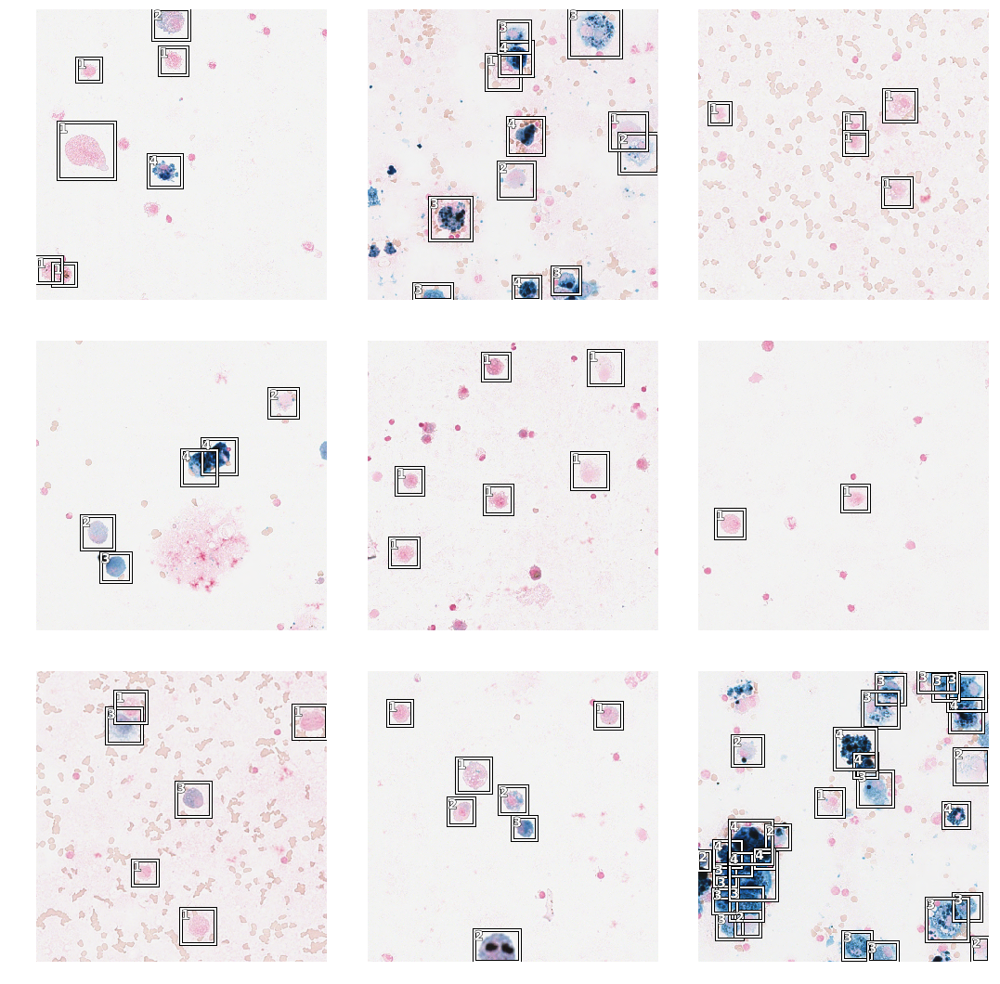

In [24]:
data.show_batch(rows=3, ds_type=DatasetType.Train, figsize=(15,15))

In [14]:
anchors_32 = create_anchors(sizes=[(32,32)], ratios=[1], scales=[0.6, 0.7, 0.9, 1.25, 1.5])

In [15]:
anchors = anchors_32

In [14]:
anchors

tensor([[-0.9688, -0.9688,  0.1500,  0.1500],
        [-0.9688, -0.9688,  0.1750,  0.1750],
        [-0.9688, -0.9688,  0.2250,  0.2250],
        ...,
        [ 0.9688,  0.9688,  0.2250,  0.2250],
        [ 0.9688,  0.9688,  0.3125,  0.3125],
        [ 0.9688,  0.9688,  0.3750,  0.3750]])

In [25]:
#anchors_16 = create_anchors(sizes=[(16,16)], ratios=[1], scales=[0,.25, 0.35, 0.46, 0.64])

In [26]:
#anchors = anchors_16

In [27]:
#anchors

tensor([[-0.9375, -0.9375,  0.0000,  0.0000],
        [-0.9375, -0.9375,  0.1250,  0.1250],
        [-0.9375, -0.9375,  0.1750,  0.1750],
        ...,
        [ 0.9375,  0.9375,  0.1750,  0.1750],
        [ 0.9375,  0.9375,  0.2300,  0.2300],
        [ 0.9375,  0.9375,  0.3200,  0.3200]])

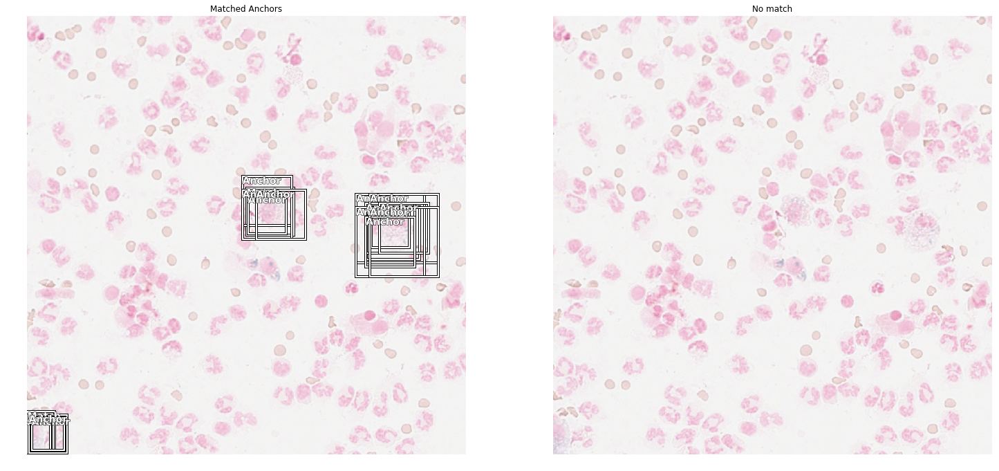

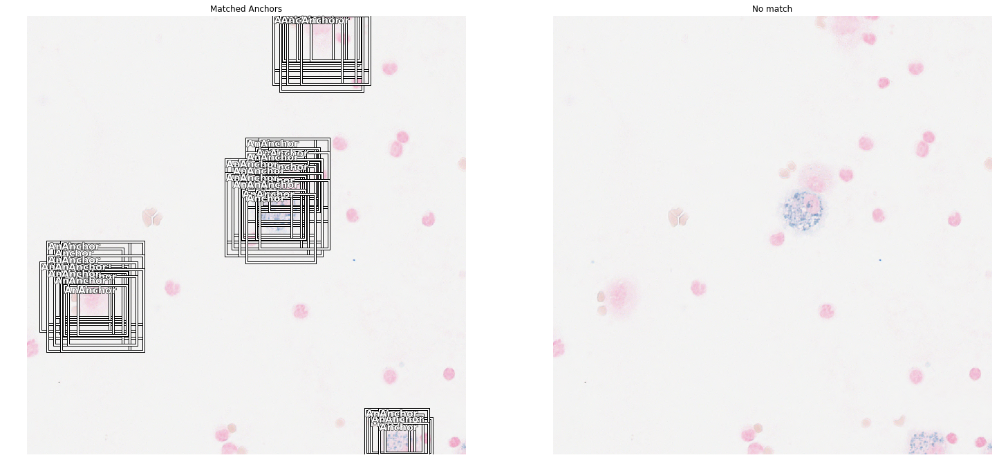

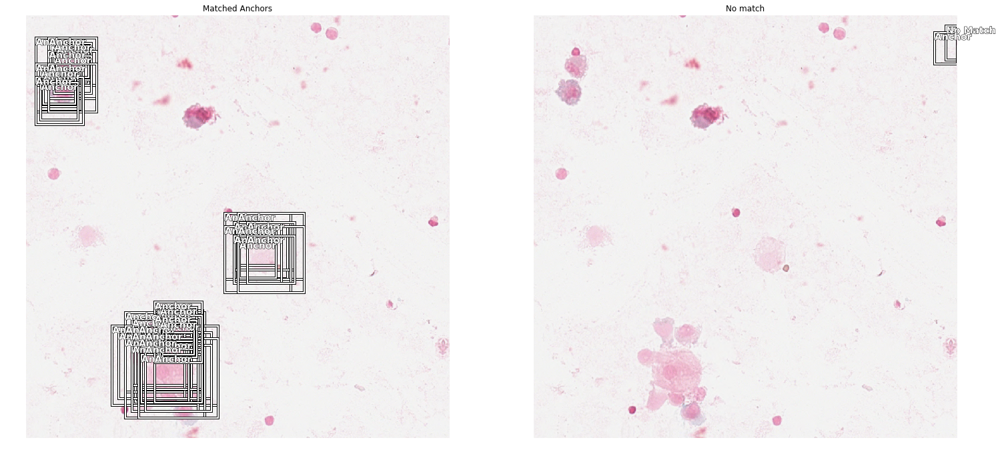

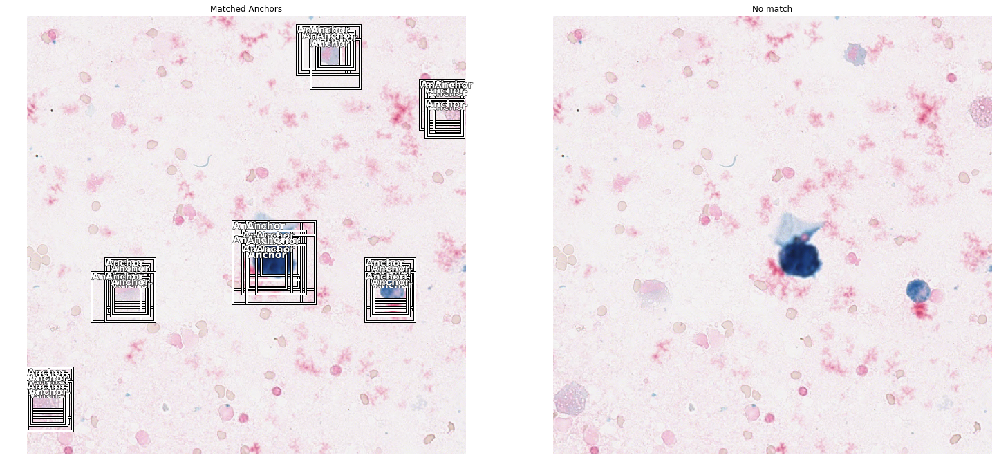

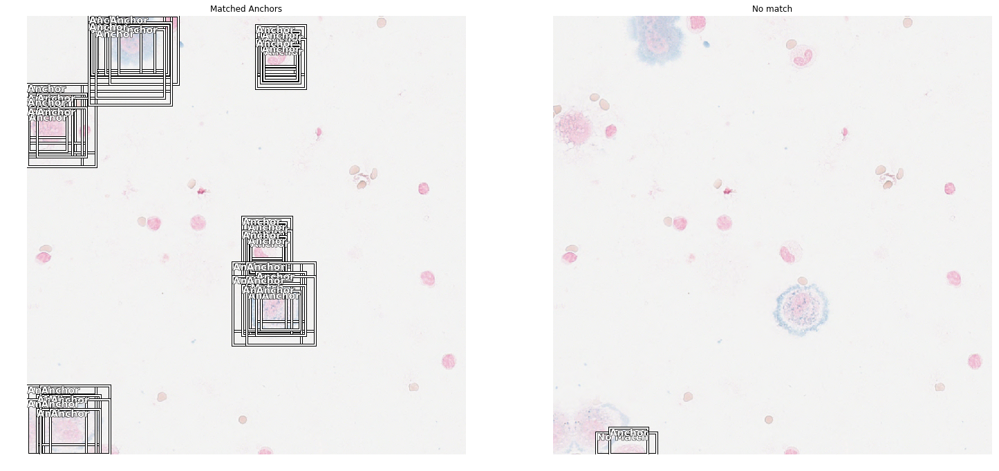

...

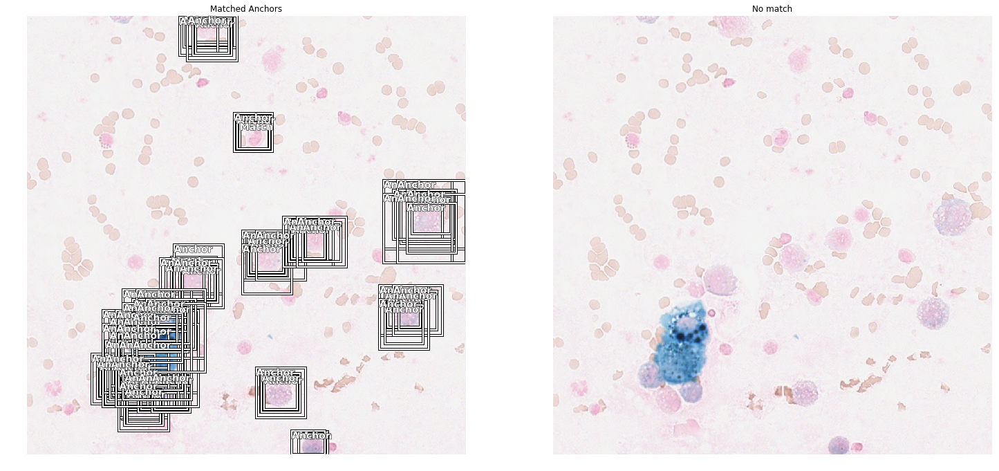

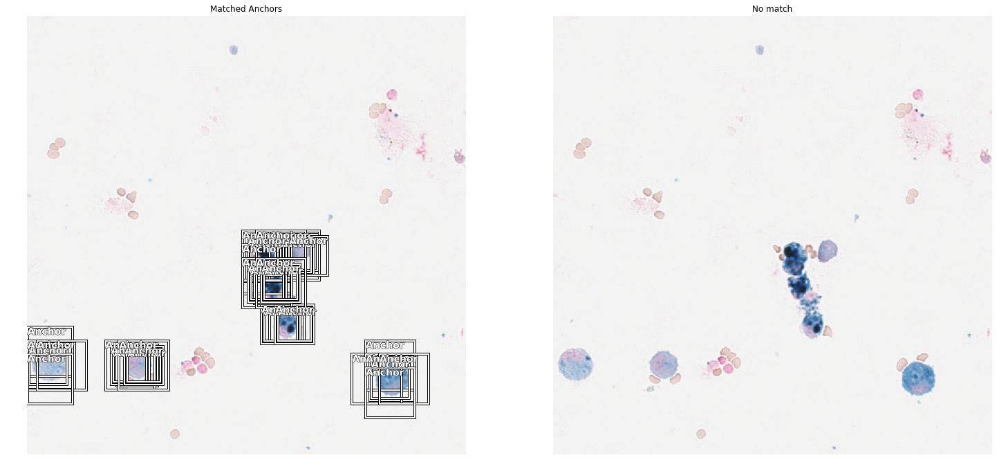

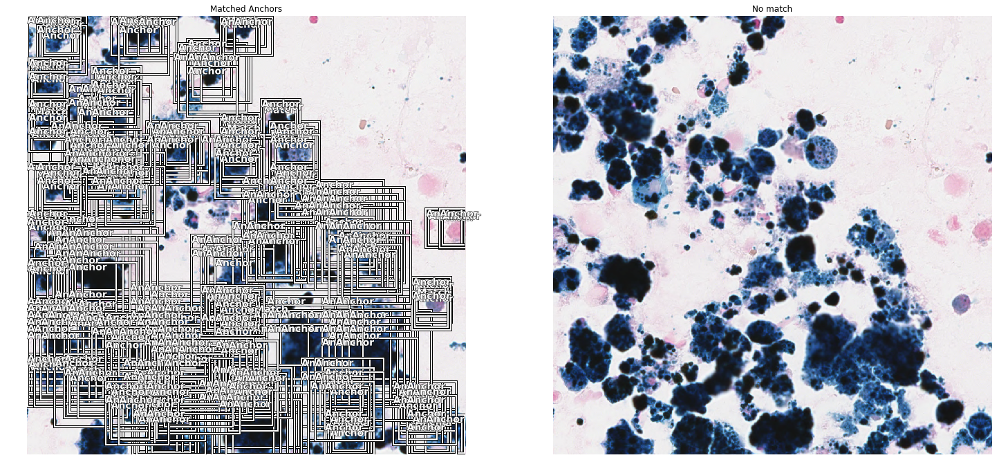

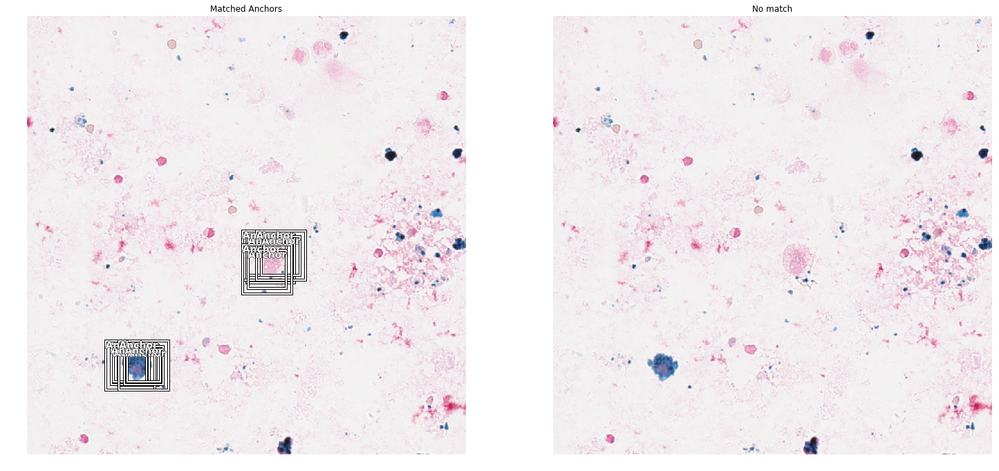

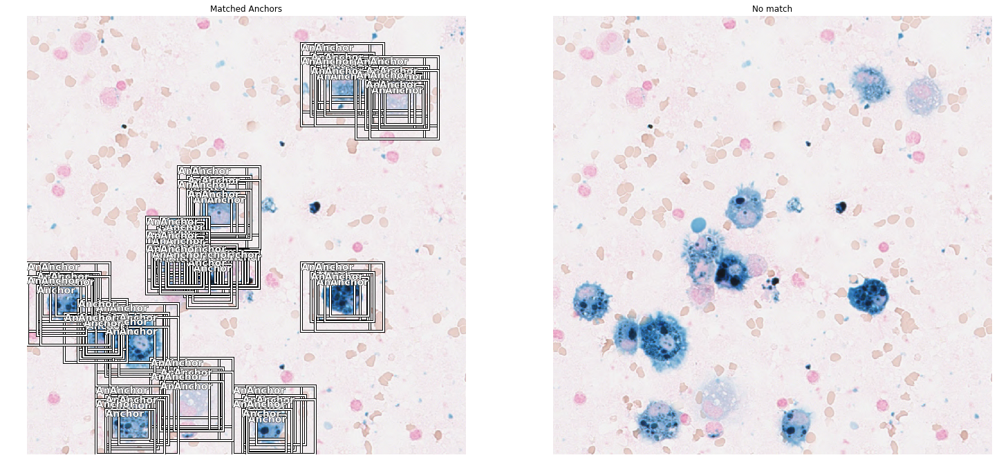

In [13]:
all_boxes, all_labels = show_anchors_on_images(data, anchors, figsize=(25,25))

In [23]:
anchors.shape

torch.Size([768, 4])

In [24]:
#anchors = torch.cat((anchors_32, anchors_16), 0)

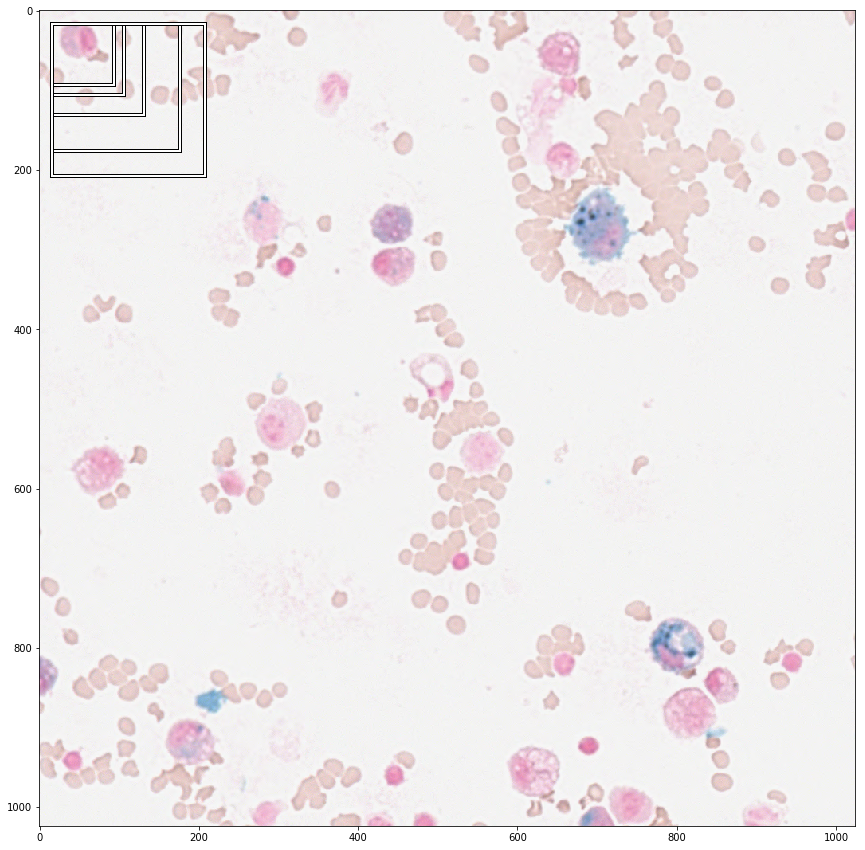

In [20]:
fig,ax = plt.subplots(figsize=(15,15))
ax.imshow(image2np(data.valid_ds[0][0].data))

for i, bbox in enumerate(anchors[:5]):
    bb = bbox.numpy()
    x = (bb[0] + 1) * size / 2 
    y = (bb[1] + 1) * size / 2 
    w = bb[2] * size / 2
    h = bb[3] * size / 2
    
    rect = [x,y,w,h]
    draw_rect(ax,rect)

In [16]:
crit = RetinaNetFocalLoss(anchors)

In [17]:
encoder = create_body(models.resnet18, True, -2)
model = RetinaNet(encoder, n_classes=data.train_ds.c, n_anchors=5, sizes=[32], chs=128, final_bias=-4., n_conv=3)

In [18]:
voc = PascalVOCMetricByDistance(anchors, size, [str(i-1) for i in data.train_ds.y.classes[1:]], radius=25)
learn = Learner(data, model, loss_func=crit, callback_fns=[BBMetrics], #BBMetrics, ShowGraph
                metrics=[voc]
               )

In [19]:
learn.split([model.encoder[6], model.c5top5])
learn.freeze_to(-2)

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


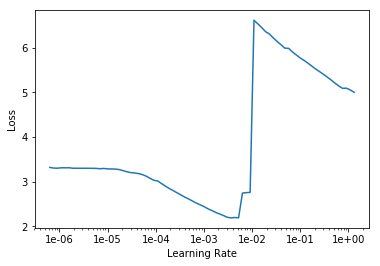

In [37]:
learn.lr_find()
learn.recorder.plot()

In [20]:
learn.fit_one_cycle(3, 1e-3)

epoch,train_loss,valid_loss,pascal_voc_metric_by_distance,BBloss,focal_loss,AP-0,AP-1,AP-2,AP-3,AP-4,time
0,0.524983,0.436883,0.453434,0.122562,0.314321,0.660450,0.561972,0.453122,0.422305,0.169319,06:22
1,0.297713,0.297097,0.494289,0.078104,0.218993,0.766000,0.567111,0.514651,0.423742,0.199943,06:06
2,0.218480,0.254569,0.579019,0.069359,0.185210,0.783132,0.662505,0.573308,0.502281,0.373869,06:02


In [21]:
learn.data.stats

[tensor([0.9176, 0.9169, 0.9295]), tensor([0.1323, 0.1038, 0.0687])]

In [19]:
data.train_ds.classes

['background', 1, 2, 3, 4, 5]

In [22]:
learn.unfreeze()
learn.fit_one_cycle(10, 1e-3)

epoch,train_loss,valid_loss,pascal_voc_metric_by_distance,BBloss,focal_loss,AP-0,AP-1,AP-2,AP-3,AP-4,time
0,0.243413,0.303124,0.493255,0.072012,0.231113,0.744629,0.524127,0.508158,0.454925,0.234439,06:08
1,0.292806,0.274074,0.513955,0.082062,0.192012,0.733869,0.746293,0.522198,0.435038,0.132379,06:10
2,0.298926,0.260619,0.605630,0.077787,0.182832,0.804430,0.769570,0.589874,0.277242,0.587034,06:10
3,0.264723,0.288257,0.586885,0.084621,0.203635,0.761157,0.690276,0.525741,0.452814,0.504438,06:07
4,0.253923,0.268953,0.542923,0.073764,0.195189,0.758761,0.789609,0.391056,0.399166,0.376022,06:06
5,0.210284,0.274550,0.558639,0.066661,0.207889,0.738624,0.703279,0.413455,0.430361,0.507475,06:06
6,0.199198,0.290925,0.480381,0.063001,0.227924,0.779638,0.539831,0.445719,0.393301,0.243416,06:06
7,0.173037,0.218581,0.586411,0.059404,0.159177,0.822802,0.747367,0.575027,0.531750,0.255107,06:11
8,0.159758,0.216898,0.608555,0.058093,0.158805,0.845186,0.728716,0.581805,0.502468,0.384598,06:07
9,0.156465,0.230185,0.595450,0.057086,0.173099,0.835554,0.714143,0.540617,0.439384,0.447551,06:06


In [23]:
learn.fit_one_cycle(10, 1e-3)

epoch,train_loss,valid_loss,pascal_voc_metric_by_distance,BBloss,focal_loss,AP-0,AP-1,AP-2,AP-3,AP-4,time
0,0.158426,0.223318,0.555434,0.057716,0.165602,0.838335,0.695526,0.567558,0.416377,0.259373,06:08
1,0.203882,0.236242,0.608847,0.066015,0.170227,0.833572,0.718165,0.602458,0.433501,0.456538,06:06
2,0.233312,0.262833,0.572052,0.073851,0.188981,0.816163,0.747464,0.585781,0.531414,0.179441,06:07
3,0.213803,0.268519,0.563272,0.069951,0.198569,0.768266,0.742081,0.583924,0.491649,0.230442,06:12
4,0.212126,0.252633,0.577902,0.066277,0.186356,0.821112,0.632377,0.514529,0.571360,0.350132,06:06
5,0.184625,0.269112,0.518581,0.063108,0.206004,0.757274,0.649091,0.412605,0.480321,0.293617,06:07
6,0.171503,0.230129,0.591410,0.061793,0.168336,0.844100,0.694674,0.511041,0.429566,0.477671,06:07
7,0.158296,0.220708,0.618623,0.059645,0.161063,0.841074,0.705498,0.645358,0.525907,0.375279,06:06
8,0.145353,0.216678,0.618718,0.057187,0.159491,0.844317,0.728635,0.622491,0.465979,0.432167,06:07
9,0.140215,0.228200,0.613698,0.057645,0.170556,0.844218,0.721693,0.588225,0.470244,0.444112,06:08


In [27]:
import pickle

stats = {"anchors": anchors,
         "mean": to_np(data.stats[0]),
         "std": to_np(data.stats[1]),
         "size": size,
         "n_classes": 6,
         "n_anchors": 5,
         "sizes": [32],
         "chs": 128,
         "encoder": "RN-18",
         "n_conv": 3,
         "level": 0,
         "model": get_model(learn.model).state_dict()
        }

torch.save(stats, "RetinaNet-L0-61.p")

In [35]:
classes = data.train_ds.classes

In [36]:
classes

['background', 1, 2, 3, 4, 5]

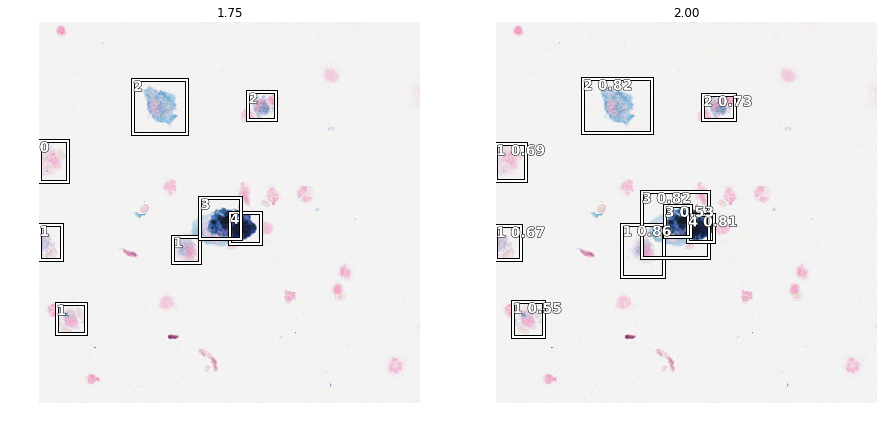

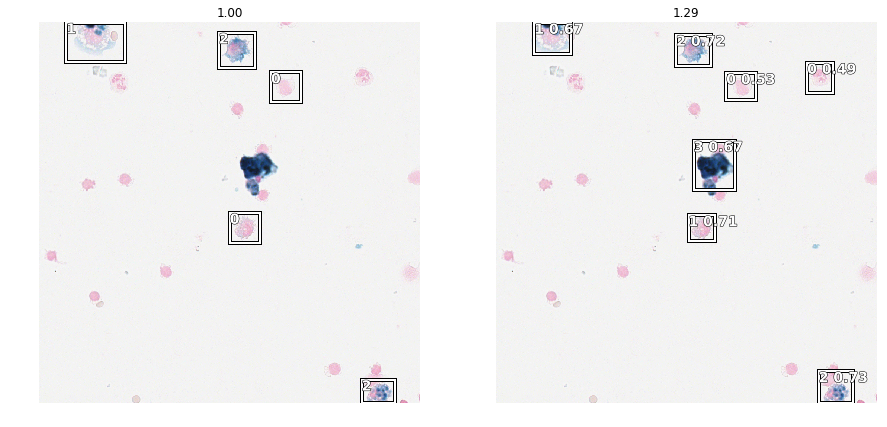

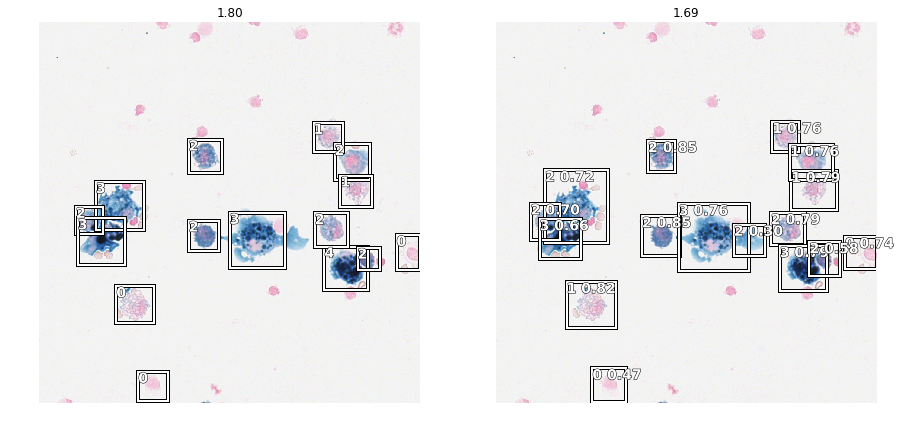

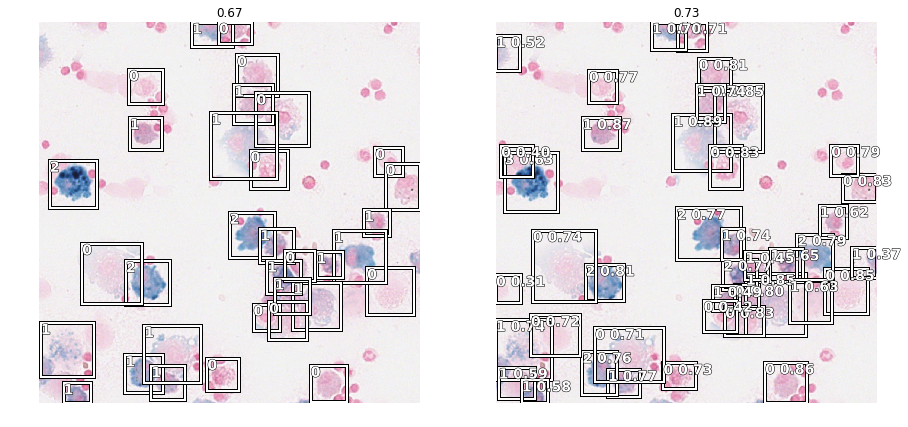

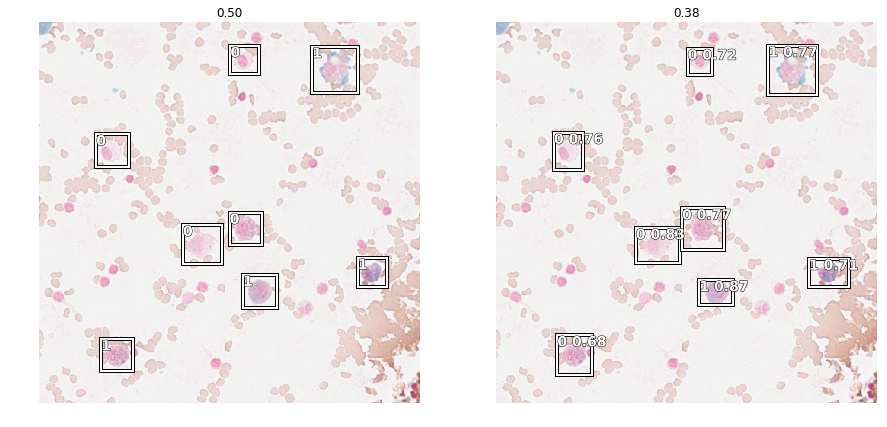

...

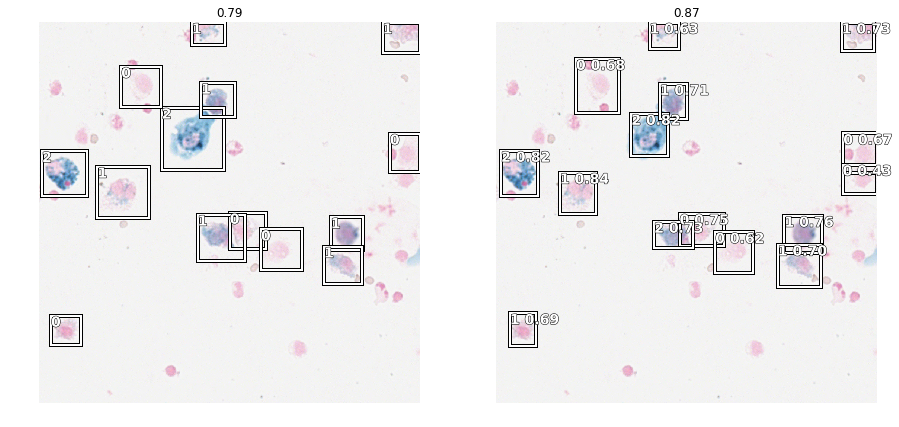

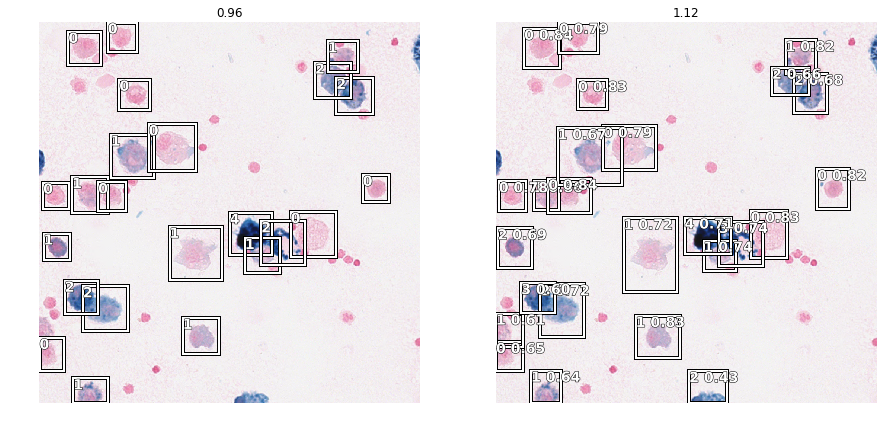

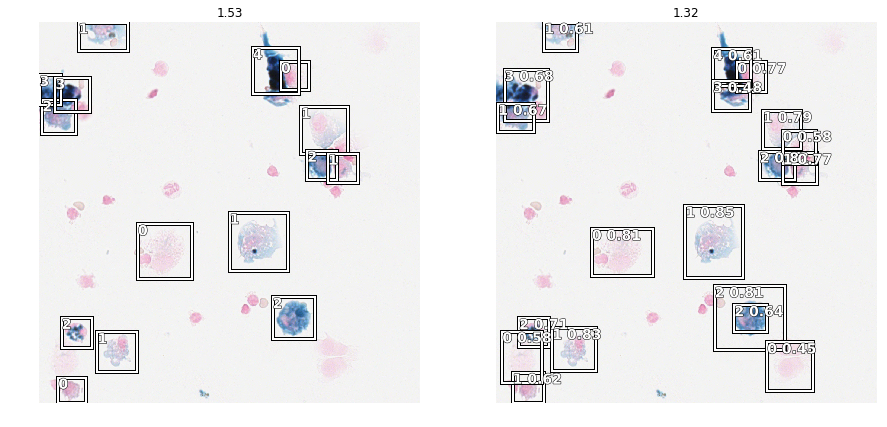

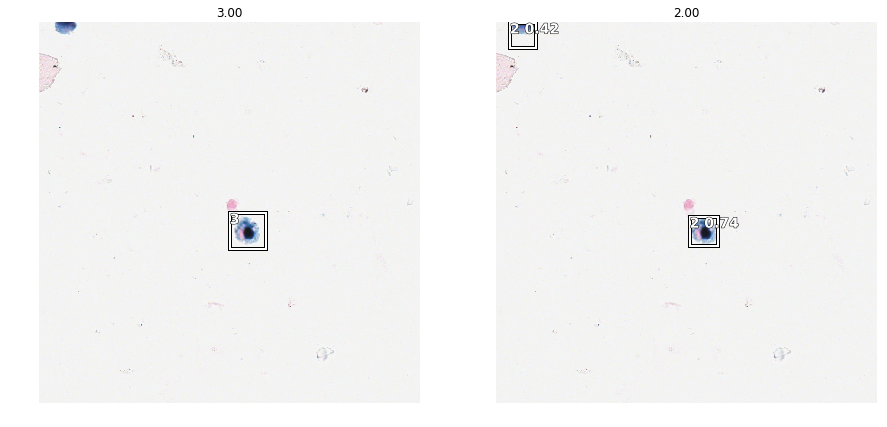

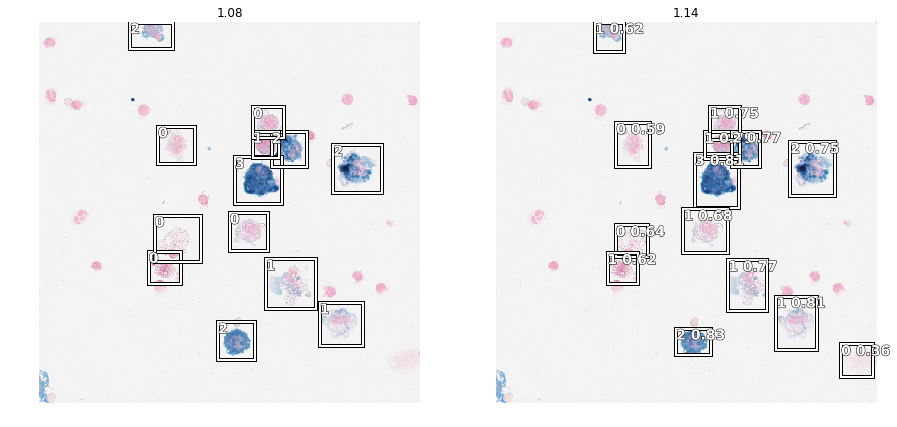

In [26]:
slide_object_result(learn, anchors, detect_thresh=0.3, nms_thresh=0.2, image_count=20)